In [1]:
# import the required libraries
import glob
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import cv2

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
dataDir = '/content/drive/My Drive/Colab Notebooks/Block Net'

In [4]:
os.listdir()

['.config', 'drive', 'sample_data']

In [5]:
os.chdir(dataDir)

In [6]:
os.listdir()

['breakhis',
 'Copy of BlockNet trainning',
 'fmc ido dataset',
 'model_BlockNet1.pt',
 'model_BlockNet(dropout).pt',
 'model_BlockNet(dropout1).pt']

In [ ]:
imgClasses = ['Ductal Carcinoma',
 'ADENOSIS',
 'TUBULAR ADENOMA',
 'MUCINOUS CARCINOMA',
 'FIBRO ADENOMA']

In [7]:
classes = ['adenosis',
 'ductal_carcinoma',
 'fibroadenoma',
 'mucinous_carcinoma',
 'tubular_adenoma']

In [8]:
import torch
import torchvision
from torchvision import datasets, transforms
from torch.utils.data.sampler import SubsetRandomSampler
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format ='retina'


In [9]:
transform = transforms.Compose([transforms.Resize((227,227)),
                                transforms.RandomHorizontalFlip(), # randomly flip and rotate
                                transforms.RandomRotation(50),
                                transforms.ToTensor(),
                                 transforms.Normalize((0.485, 0.456, 0.406),      
                                                      (0.229, 0.224, 0.225))
                               ])


testData = dataDir+"/fmc ido dataset"
dataDir = dataDir+"/breakhis"

In [10]:
dataDir

'/content/drive/My Drive/Colab Notebooks/Block Net/breakhis'

In [11]:
testData

'/content/drive/My Drive/Colab Notebooks/Block Net/fmc ido dataset'

In [13]:
# number of subprocesses to use for data loading
numWorkers = 0
# how many samples per batch to load
batchSize = 34
# percentage of training set to use as validation
validSize = 0.3

trainset = datasets.ImageFolder(dataDir, transform = transform)
testSet = datasets.ImageFolder(testData, transform = transform)

numTrain = len(trainset)
print("numTrain ="+str(numTrain))
idx = list(range(numTrain))
np.random.shuffle(idx)
split = int(np.floor(validSize * numTrain))
trainIdx, validIdx = idx[split:], idx[:split]

#log_file = '/content/drive/My Drive/Colab Notebooks/Block-Network/training_log.txt'

# define samplers for obtaining training and validation batches
trainSampler = SubsetRandomSampler(trainIdx)
print("trainSampler = {}".format({len(trainSampler)}))

validSampler = SubsetRandomSampler(validIdx)
print("validSampler = {}".format({len(validSampler)}))


print("test file = {}".format({len(testSet)}))


numTrain =1564
trainSampler = {1095}
validSampler = {469}
test file = {1876}


In [ ]:
1876/34

55.1764705882353

**try to train the data without batch size that is using batch mode**

In [ ]:
'''
# number of subprocesses to use for data loading
numWorkers = 0
# how many samples per batch to load
batchSize = 0
# percentage of training set to use as validation
validSize = 0.2

trainset = datasets.ImageFolder(dataDir,transform = transform)
numTrain = len(trainset)
print("numTrain ="+str(numTrain))
idx = list(range(numTrain))
np.random.shuffle(idx)
split = int(np.floor(validSize * numTrain))
trainIdx, validIdx = idx[split:], idx[:split]



# define samplers for obtaining training and validation batches
trainSampler = SubsetRandomSampler(trainIdx)
print("trainSampler = {}".format({len(trainSampler)}))

validSampler = SubsetRandomSampler(validIdx)
print("validSampler = {}".format({len(validSampler)}))

trainLoader = torch.utils.data.DataLoader(trainset,sampler=trainSampler, num_workers=numWorkers)
validLoader = torch.utils.data.DataLoader(trainset,sampler=validSampler,num_workers=numWorkers)

#shuffle=True) 
'''

'\n# number of subprocesses to use for data loading\nnumWorkers = 0\n# how many samples per batch to load\nbatchSize = 0\n# percentage of training set to use as validation\nvalidSize = 0.2\n\ntrainset = datasets.ImageFolder(dataDir,transform = transform)\nnumTrain = len(trainset)\nprint("numTrain ="+str(numTrain))\nidx = list(range(numTrain))\nnp.random.shuffle(idx)\nsplit = int(np.floor(validSize * numTrain))\ntrainIdx, validIdx = idx[split:], idx[:split]\n\n\n\n# define samplers for obtaining training and validation batches\ntrainSampler = SubsetRandomSampler(trainIdx)\nprint("trainSampler = {}".format({len(trainSampler)}))\n\nvalidSampler = SubsetRandomSampler(validIdx)\nprint("validSampler = {}".format({len(validSampler)}))\n\ntrainLoader = torch.utils.data.DataLoader(trainset,sampler=trainSampler, num_workers=numWorkers)\nvalidLoader = torch.utils.data.DataLoader(trainset,sampler=validSampler,num_workers=numWorkers)\n\n#shuffle=True) \n'

In [14]:
trainLoader = torch.utils.data.DataLoader(trainset,batch_size=batchSize,sampler=trainSampler, num_workers=numWorkers)
validLoader = torch.utils.data.DataLoader(trainset,batch_size=batchSize, sampler=validSampler,num_workers=numWorkers)
testLoader  = torch.utils.data.DataLoader(testSet,batch_size=batchSize, num_workers=numWorkers)
#shuffle=True)

In [15]:
testLoader.dataset.class_to_idx

{'adenosis': 0,
 'ductal carcinoma': 1,
 'fibro adenoma': 2,
 'mucinous carcinoma': 3,
 'tubular adenoma': 4}

In [16]:
testLoader.dataset.classes

['adenosis',
 'ductal carcinoma',
 'fibro adenoma',
 'mucinous carcinoma',
 'tubular adenoma']

In [17]:
trainLoader.dataset.classes

['adenosis',
 'ductal_carcinoma',
 'fibroadenoma',
 'mucinous_carcinoma',
 'tubular_adenoma']

In [18]:
type(trainset)

torchvision.datasets.folder.ImageFolder

In [19]:
import matplotlib.pyplot as plt
import numpy as np
from torch import nn, optim
from torch.autograd import Variable


def test_network(net, trainloader):

    criterion = nn.MSELoss()
    optimizer = optim.Adam(net.parameters(), lr=0.001)

    dataiter = iter(trainloader)
    images, labels = dataiter.next()

    # Create Variables for the inputs and targets
    inputs = Variable(images)
    targets = Variable(images)

    # Clear the gradients from all Variables
    optimizer.zero_grad()

    # Forward pass, then backward pass, then update weights
    output = net.forward(inputs)
    loss = criterion(output, targets)
    loss.backward()
    optimizer.step()

    return True


def imshow(image, ax=None, title=None, normalize=True):
    """Imshow for Tensor."""
    if ax is None:
        fig, ax = plt.subplots()
    image = image.numpy().transpose((1, 2, 0))

    if normalize:
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        image = std * image + mean
        image = np.clip(image, 0, 1)

    ax.imshow(image)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.tick_params(axis='both', length=0)
    ax.set_xticklabels('')
    ax.set_yticklabels('')

    return ax


def view_recon(img, recon):
    ''' Function for displaying an image (as a PyTorch Tensor) and its
        reconstruction also a PyTorch Tensor
    '''

    fig, axes = plt.subplots(ncols=2, sharex=True, sharey=True)
    axes[0].imshow(img.numpy().squeeze())
    axes[1].imshow(recon.data.numpy().squeeze())
    for ax in axes:
        ax.axis('off')
        ax.set_adjustable('box-forced')

def view_classify(img, ps, version="FMC"):
    ''' Function for viewing an image and it's predicted classes.
    '''
    ps = ps.data.numpy().squeeze()

    fig, (ax1, ax2) = plt.subplots(figsize=(6,9), ncols=2)
    ax1.imshow(img.resize_(1, 28, 28).numpy().squeeze())
    ax1.axis('off')
    ax2.barh(np.arange(10), ps)
    ax2.set_aspect(0.1)
    ax2.set_yticks(np.arange(10))
    if version == "FMC":
        ax2.set_yticklabels(np.arange(10))
    elif version == "fash":
        ax2.set_yticklabels(['adenosis',
 'ductal_carcinoma',
 'fibroadenoma',
 'mucinous_carcinoma',
 'tubular_adenoma'], size='small');
    ax2.set_title('Class Probability')
    ax2.set_xlim(0, 1.1)

    plt.tight_layout()

In [ ]:
# from torch.utils.tensorboard import SummaryWriter
# tb = SummaryWriter()

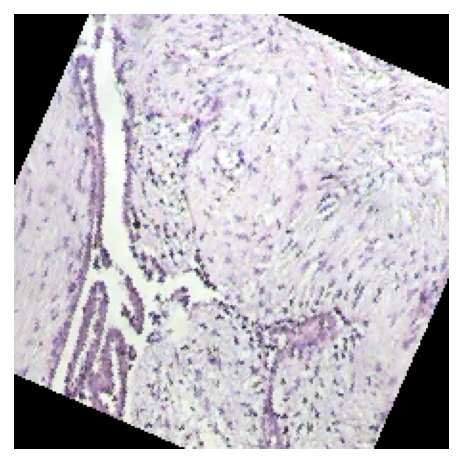

In [20]:
#import helper
images,labels = next(iter(trainLoader))
#grid = torchvision.utils.make_grid(images)
imshow(images[5])


In [ ]:
# tb.add_image("images",grid)
# tb.add_graph(model,images)
# tb.close()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


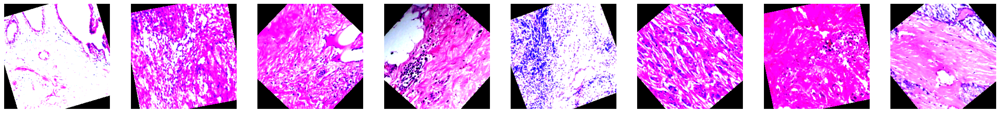

In [21]:
# change this to the trainloader or testloader 
data_iter = iter(trainLoader)

images, labels = next(data_iter)
fig, axes = plt.subplots(figsize=(30,6), ncols=8)

for ii in range(8):
    ax = axes[ii]
    imshow(images[ii], ax=ax, normalize=False)

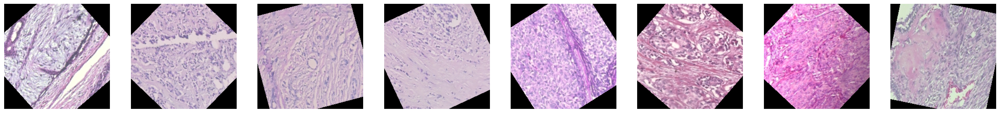

In [22]:
# change this to the trainloader or testloader 
data_iter = iter(trainLoader)

images, labels = next(data_iter)
fig, axes = plt.subplots(figsize=(30,6), ncols=8)

for ii in range(8):
    ax = axes[ii]
    imshow(images[ii], ax=ax, normalize=True)

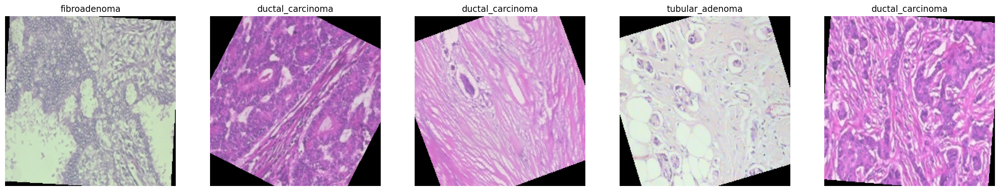

In [24]:
import numpy as np
#from helper import imshow
# obtain one batch of training images
dataiter = iter(trainLoader)
images, labels = dataiter.next()
#images = images.numpy() # convert images to numpy for display

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(50, 10))
# display 20 images
for idx in np.arange(5):
    ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
    imshow(images[idx], ax=ax, normalize=True)
    ax.set_title(classes[labels[idx]])

In [ ]:
"""
rgb_img = np.squeeze(images[3])
channels = ['red channel', 'green channel', 'blue channel']

fig = plt.figure(figsize = (36, 36)) 
for idx in np.arange(rgb_img.shape[0]):
    ax = fig.add_subplot(1, 3, idx + 1)
    img = rgb_img[idx]
    ax.imshow(img, cmap='gray')
    ax.set_title(channels[idx])
    width, height = img.shape
    thresh = img.max()/2.5
    for x in range(width):
        for y in range(height):
            val = torch.round(img[x][y],2) if img[x][y] !=0 else 0
            ax.annotate(str(val), xy=(y,x),
                    horizontalalignment='center',
                    verticalalignment='center', size=8,
                    color='white' if img[x][y]<thresh else 'black') """

"\nrgb_img = np.squeeze(images[3])\nchannels = ['red channel', 'green channel', 'blue channel']\n\nfig = plt.figure(figsize = (36, 36)) \nfor idx in np.arange(rgb_img.shape[0]):\n    ax = fig.add_subplot(1, 3, idx + 1)\n    img = rgb_img[idx]\n    ax.imshow(img, cmap='gray')\n    ax.set_title(channels[idx])\n    width, height = img.shape\n    thresh = img.max()/2.5\n    for x in range(width):\n        for y in range(height):\n            val = torch.round(img[x][y],2) if img[x][y] !=0 else 0\n            ax.annotate(str(val), xy=(y,x),\n                    horizontalalignment='center',\n                    verticalalignment='center', size=8,\n                    color='white' if img[x][y]<thresh else 'black') "

In [25]:
trainLoader.dataset.classes

['adenosis',
 'ductal_carcinoma',
 'fibroadenoma',
 'mucinous_carcinoma',
 'tubular_adenoma']

In [26]:
train_on_gpu = torch.cuda.is_available()
# check if CUDA is available
train_on_gpu = torch.cuda.is_available()

if not train_on_gpu:
  
    print('CUDA is not available.  Training on CPU ...')
else:
    print('CUDA is available!  Training on GPU ...')

CUDA is available!  Training on GPU ...


**Architecture Without Dropout**

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.init as I
 
 
class BlockNet(nn.Module):
  def __init__(self, nClasses):
    super(BlockNet,self).__init__()
    #input image = 227x227  kernel size = 3 
    #CONV1
    ## output size = (W-F)/S +1 = (227-3)/2 +1 = 113
    # the output Tensor for one image, will have the dimensions: (64, 113, 113)
    self.conv1 = nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, stride=2)
    self.cnnBN1 = nn.BatchNorm2d(64)
 
    #CONV2
    ## output size = (W-F)/S +1 = (113-3)/2 +1 = 56
    #the output Tensor for one image, will have the dimensions: (64, 56, 56)
    self.conv2 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, stride=2) #(109)
    self.cnnBN2 = nn.BatchNorm2d(64)
 
    #CONV3
    ## output size = (W-F)/S +1 = (56-3)/1 +1 = 54
    # the output Tensor for one image, will have the dimensions: (128, 54, 54)
    # pool = (W-F)/S + 1 = (54-2)/2 + 1 = 27
    # after one pool layer, this becomes (128, 27, 27)
    self.conv3 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, stride=1)
    self.cnnBN3 = nn.BatchNorm2d(128)
    self.pool1 = nn.MaxPool2d(2,2)
    
 
    #CONV4
    ## output size = (W-F)/S +1 = (27-3)/2 +1 = 13
    # the output Tensor for one image, will have the dimensions (265,13,13)
    self.conv4 = nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, stride=2)
    self.cnnBN4 = nn.BatchNorm2d(256)
 
    #Conv5
    ## output size = (W-F)/S +1 = (13-3)/2 +1 = 7
    # the output Tensor for one image, will have the dimensions (512,7,7)
    # pool = (W-F)/S + 1 = (7-2)/2 + 1 = 3
    # after one pool layer, this becomes (512, 3, 3)
    self.conv5 = nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, stride=2)
    self.cnnBN5 = nn.BatchNorm2d(512)
    self.pool2 = nn.MaxPool2d(2,2)
 
    #self.batchNorm = nn.BatchNormalization2d()
    #self.batchNorm = nn.BatchNorm2d()
 
    ## LINEAR LAYER
    self.fc1 = nn.Linear(in_features = 512 * 3 * 3, out_features= 4608)
    self.fcBN1 = nn.BatchNorm1d(4608)
    self.fc2 = nn.Linear(in_features = 4608, out_features=3608)
    self.fcBN2 = nn.BatchNorm1d(3608)
    self.fc3 = nn.Linear(in_features = 3608, out_features=1000)
    self.fcBN3 = nn.BatchNorm1d(1000)
    # output 5 classes
    self.fc4 = nn.Linear (in_features = 1000, out_features = nClasses)
 
 
  def forward(self,x):
    x = self.conv1(x)
    x = self.cnnBN1(x)
    x = F.relu(x)
    #x = self.batcNorm(64)

    x = self.conv2(x)
    x = self.cnnBN2(x)
    #x = self.batchNorm()
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)
    #x = self.batcNorm(64)

    x = self.pool1(self.conv3(x))
    x = self.cnnBN3(x)
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)
    #x = self.batchNorm(128)

    x = self.conv4(x)
    x = self.cnnBN4(x)
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)
    #x = self.batchNorm(256)
    

    x = self.pool2(self.conv5(x))
    x = self.cnnBN5(x)
    # x = self.batchNorm
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)
    #x = self.batchNorm(512)

                                                        # print("#############")
                                                        # print("shape of x is {}".format(x.size()))
    ## Flatten image input
    x = x.view(x.size(0),-1)
    x = self.fc1(x)
    x = self.fcBN1(x)
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)

    #x = self.batchNorm(4608)
    x = self.fc2(x)
    x = self.fcBN2(x)
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)

    #x = self.batchNorm(3608)
    x = self.fc3(x)
    x = self.fcBN3(x)
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)
    x = F.softmax(self.fc4(x),dim=1)
 
    return x
 
 

In [ ]:
model = BlockNet(nClasses=5)   
print(model)

BlockNet(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2))
  (cnnBN1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2))
  (cnnBN2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
  (cnnBN3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv4): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2))
  (cnnBN4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv5): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2))
  (cnnBN5): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=4608, out_features

In [ ]:
# move tensors to GPU if CUDA is available
if train_on_gpu:
    model.cuda()
    
#Define the optimizer 
import torch.optim as optim

# optimizer = optim.RMSprop(model.parameters(), lr=0.01)
optimizer = optim.Adam(model.parameters(), lr=0.01)

#Define the loss
lossFunction = nn.CrossEntropyLoss()

In [ ]:
# nEpochs = 50
# for epoch in range(1,nEpochs+1):
#     train_loss = 0
#     model.train()
#     for batch_idx,(data,target) in enumerate(trainLoader):
#         # print("############# DATA SHAPE ##############")
#         # print(data.size())
#         # print("label shape")
#         # print(labels.size())
#         if train_on_gpu:
#             data, target = data.cuda(), target.cuda()
#             # print(type(data))
#         optimizer.zero_grad()
#         output = model(data)
#         loss = lossFunction(output,target)
#         loss.backward()
#         optimizer.step()
#         train_loss += loss.item()*data.size(0)
#     train_loss /=len(trainLoader.dataset)
    
#     print("Epoch: {}  Training Loss : {:.6f}".format(epoch,train_loss))

In [ ]:
optimizer


Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.01
    weight_decay: 0
)

In [ ]:
def train_net(n_epochs):

    # prepare the net for training
    model.train()

    for epoch in range(n_epochs):  # loop over the dataset multiple times
        
        running_loss = 0.0

        # train on batches of data, assumes you already have train_loader
        for batch_i, (data,target) in enumerate(trainLoader):
            # get the input images and their corresponding labels
            if train_on_gpu:
              data, target = data.cuda(), target.cuda()

            # forward pass to get outputs
            output_ = model(data)

            # calculate the loss between predicted and target keypoints
            loss = lossFunction(output_, target)

            # zero the parameter (weight) gradients
            optimizer.zero_grad()
            
            # backward pass to calculate the weight gradients
            loss.backward()

            # update the weights
            optimizer.step()

            # print loss statistics
            # to convert loss into a scalar and add it to the running_loss, use .item()
            running_loss += loss.item()
            if batch_i % 10 == 9:    # print every 10 batches
                print('Epoch: {}, Batch: {}, Avg. Loss: {}'.format(epoch + 1, batch_i+1, running_loss/1000))
                running_loss = 0.0

    print('Finished Training')

In [ ]:
# train_net(100)

In [ ]:
# train_net(100)

In [ ]:
from torch.utils.tensorboard import SummaryWriter

In [ ]:
writer = SummarryWriter(logd)

**Train Batch Mode**

In [ ]:
# number of epochs to train the model
n_epochs = 15

valid_loss_min = np.Inf # track change in validation loss

for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    runningLoss =[]
    
    ###################
    # train the model #
    ###################
    model.train()
    for data, target in trainLoader:
        # move tensors to GPU if CUDA is available
        if train_on_gpu:
            data, target = data.cuda(), target.cuda()
        # clear the gradients of all optimized variables
        optimizer.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the batch loss
        loss = lossFunction(output, target)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer.step()
        # update training loss
        train_loss += loss.item()*data.size(0)
        
    ######################    
    # validate the model #
    ######################
    model.eval()
    for data, target in validLoader:
        # move tensors to GPU if CUDA is available
        if train_on_gpu:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the batch loss
        loss = lossFunction(output, target)
        # update average validation loss 
        valid_loss += loss.item()*data.size(0)
    
    # calculate average losses
    train_loss = train_loss/len(trainLoader.sampler)
    valid_loss = valid_loss/len(validLoader.sampler)
        
    # print training/validation statistics 
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch, train_loss, valid_loss))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save(model.state_dict(), '/content/drive/My Drive/Colab Notebooks/Block Net//model_BlockNet1.pt')
        valid_loss_min = valid_loss
    # fig,ax = plt.subplot()    
    # ax.plot(train_loss, label="Train Loss")
    # ax.plot(valid_loss, label="Valid Loss")
    # ax.title("Complexity Graph")
    # ax.set_xlabel('Epoch iteration')
    # ax.set_ylabel('Error')
    # ax.legend

    # plt.figure(figsize=(10,5))
    # plt.title("Training and Validation Loss")
    # plt.plot(valid_loss,label="val")
    # plt.plot(train_loss,label="train")
    # plt.xlabel("iterations")
    # plt.ylabel("Loss")
    # plt.legend()
    # plt.show()

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Epoch: 1 	Training Loss: 1.337709 	Validation Loss: 1.322744
Validation loss decreased (inf --> 1.322744).  Saving model ...
Epoch: 2 	Training Loss: 1.329490 	Validation Loss: 1.322742
Validation loss decreased (1.322744 --> 1.322742).  Saving model ...
Epoch: 3 	Training Loss: 1.329491 	Validation Loss: 1.322743
Epoch: 4 	Training Loss: 1.329491 	Validation Loss: 1.322743
Epoch: 5 	Training Loss: 1.329490 	Validation Loss: 1.322744
Epoch: 6 	Training Loss: 1.329490 	Validation Loss: 1.322741
Validation loss decreased (1.322742 --> 1.322741).  Saving model ...
Epoch: 7 	Training Loss: 1.329489 	Validation Loss: 1.322742
Epoch: 8 	Training Loss: 1.329491 	Validation Loss: 1.322742
Epoch: 9 	Training Loss: 1.329489 	Validation Loss: 1.322742
Epoch: 10 	Training Loss: 1.329490 	Validation Loss: 1.322743
Epoch: 11 	Training Loss: 1.329489 	Validation Loss: 1.322733
Validation loss decreased (1.322741 --> 1.322733).  Saving model ...
Epoch: 12 	Training Loss: 1.329541 	Validation Loss: 1.3

In [ ]:
# #open the training log file
# f = open(log_file, 'w')
# # number of epochs to train the model
# n_epochs = 10

# valid_loss_min = np.Inf # track change in validation loss

# for epoch in range(1, n_epochs+1):

#     # keep track of training and validation loss
#     train_loss = 0.0
#     valid_loss = 0.0
    
#     ###################
#     # train the model #
#     ###################
#     model.train()
#     for data, target in trainLoader:
#         # move tensors to GPU if CUDA is available
#         if train_on_gpu:
#             data, target = data.cuda(), target.cuda()
#         # clear the gradients of all optimized variables
#         optimizer.zero_grad()
#         # forward pass: compute predicted outputs by passing inputs to the model
#         output = model(data)
#         # calculate the batch loss
#         loss = lossFunction(output, target)
#         # backward pass: compute gradient of the loss with respect to model parameters
#         loss.backward()
#         # perform a single optimization step (parameter update)
#         optimizer.step()
#         # update training loss
#         train_loss += loss.item()*data.size(0)
        
#     ######################    
#     # validate the model #
#     ######################
#     model.eval()
#     for data, target in validLoader:
#         # move tensors to GPU if CUDA is available
#         if train_on_gpu:
#             data, target = data.cuda(), target.cuda()
#         # forward pass: compute predicted outputs by passing inputs to the model
#         output = model(data)
#         # calculate the batch loss
#         loss = lossFunction(output, target)
#         # update average validation loss 
#         valid_loss += loss.item()*data.size(0)
    
#     # calculate average losses
#     train_loss = train_loss/len(trainLoader.sampler)
#     valid_loss = valid_loss/len(validLoader.sampler)
        
#     # print training/validation statistics 
#     print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
#         epoch, train_loss, valid_loss))
    
#     # save model if validation loss has decreased
#     if valid_loss <= valid_loss_min:
#         print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
#         valid_loss_min,
#         valid_loss))
#         torch.save(model.state_dict(), '/content/drive/My Drive/Colab Notebooks/Block Net/model_BlockNet2.pt')
#         valid_loss_min = valid_loss
#     fig,ax = plt.subplot()    
#     plt.plot(train_loss, label="Train Loss")
#     plt.plot(valid_loss, label="Valid Loss")
#     plt.title("Complexity Graph")
#     plt.set_xlabel('Epoch iteration')
#     plt.set_ylabel('Error')
#     plt.legend
# #close the training log file
# f.close()

In [ ]:
# #open the training log file
# f = open(log_file, 'w')
# # number of epochs to train the model
# n_epochs = 100

# valid_loss_min = np.Inf # track change in validation loss

# for epoch in range(1, n_epochs+1):

#     # keep track of training and validation loss
#     train_loss = 0.0
#     valid_loss = 0.0
    
#     ###################
#     # train the model #
#     ###################
#     model.train()
#     for data, target in trainLoader:
#         # move tensors to GPU if CUDA is available
#         if train_on_gpu:
#             data, target = data.cuda(), target.cuda()
#         # clear the gradients of all optimized variables
#         optimizer.zero_grad()
#         # forward pass: compute predicted outputs by passing inputs to the model
#         output = model(data)
#         # calculate the batch loss
#         loss = lossFunction(output, target)
#         # backward pass: compute gradient of the loss with respect to model parameters
#         loss.backward()
#         # perform a single optimization step (parameter update)
#         optimizer.step()
#         # update training loss
#         train_loss += loss.item()*data.size(0)
        
#     ######################    
#     # validate the model #
#     ######################
#     model.eval()
#     for data, target in validLoader:
#         # move tensors to GPU if CUDA is available
#         if train_on_gpu:
#             data, target = data.cuda(), target.cuda()
#         # forward pass: compute predicted outputs by passing inputs to the model
#         output = model(data)
#         # calculate the batch loss
#         loss = lossFunction(output, target)
#         # update average validation loss 
#         valid_loss += loss.item()*data.size(0)
    
#     # calculate average losses
#     train_loss = train_loss/len(trainLoader.sampler)
#     valid_loss = valid_loss/len(validLoader.sampler)
        
#     # print training/validation statistics 
#     print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
#         epoch, train_loss, valid_loss))
    
#     # save model if validation loss has decreased
#     if valid_loss <= valid_loss_min:
#         print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
#         valid_loss_min,
#         valid_loss))
#         torch.save(model.state_dict(), '/content/drive/My Drive/Colab Notebooks/Block Net/model_BlockNet3.pt')
#         valid_loss_min = valid_loss
#     fig,ax = plt.subplot()    
#     plt.plot(train_loss, label="Train Loss")
#     plt.plot(valid_loss, label="Valid Loss")
#     plt.title("Complexity Graph")
#     plt.set_xlabel('Epoch iteration')
#     plt.set_ylabel('Error')
#     plt.legend
# #close the training log file
# f.close()

Add Dropout to the architecture and observe the loss of the network

In [27]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.init as I
 
 
class BlockNet(nn.Module):
  def __init__(self, nClasses):
    super(BlockNet,self).__init__()
    #input image = 227x227  kernel size = 3 
    #CONV1
    ## output size = (W-F)/S +1 = (227-3)/2 +1 = 113
    # the output Tensor for one image, will have the dimensions: (64, 113, 113)
    self.conv1 = nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, stride=2)
    self.cnnBN1 = nn.BatchNorm2d(64)
    self.drop1 = nn.Dropout(0.2)
 
    #CONV2
    ## output size = (W-F)/S +1 = (113-3)/2 +1 = 56
    #the output Tensor for one image, will have the dimensions: (64, 56, 56)
    self.conv2 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, stride=2) #(109)
    self.cnnBN2 = nn.BatchNorm2d(64)
    self.drop2 = nn.Dropout(0.2)
 
    #CONV3
    ## output size = (W-F)/S +1 = (56-3)/1 +1 = 54
    # the output Tensor for one image, will have the dimensions: (128, 54, 54)
    # pool = (W-F)/S + 1 = (54-2)/2 + 1 = 27
    # after one pool layer, this becomes (128, 27, 27)
    self.conv3 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, stride=1)
    self.cnnBN3 = nn.BatchNorm2d(128)
    self.pool1 = nn.MaxPool2d(2,2)
    self.drop3 = nn.Dropout(0.2)

    
 
    #CONV4
    ## output size = (W-F)/S +1 = (27-3)/2 +1 = 13
    # the output Tensor for one image, will have the dimensions (265,13,13)
    self.conv4 = nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, stride=2)
    self.cnnBN4 = nn.BatchNorm2d(256)
    self.drop4 = nn.Dropout(0.2)
 
    #Conv5
    ## output size = (W-F)/S +1 = (13-3)/2 +1 = 7
    # the output Tensor for one image, will have the dimensions (512,7,7)
    # pool = (W-F)/S + 1 = (7-2)/2 + 1 = 3
    # after one pool layer, this becomes (512, 3, 3)
    self.conv5 = nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, stride=2)
    self.cnnBN5 = nn.BatchNorm2d(512)
    self.pool2 = nn.MaxPool2d(2,2)
    self.drop5 = nn.Dropout(0.2)
 
    #self.batchNorm = nn.BatchNormalization2d()
    #self.batchNorm = nn.BatchNorm2d()
 
    ## LINEAR LAYER
    self.fc1 = nn.Linear(in_features = 512 * 3 * 3, out_features= 4608)
    self.fcBN1 = nn.BatchNorm1d(4608)
    self.drop6 = nn.Dropout(0.2)
    self.fc2 = nn.Linear(in_features = 4608, out_features=3608)
    self.fcBN2 = nn.BatchNorm1d(3608)
    self.drop7 = nn.Dropout(0.2)
    self.fc3 = nn.Linear(in_features = 3608, out_features=1000)
    self.fcBN3 = nn.BatchNorm1d(1000)
    self.drop8 = nn.Dropout(0.2)
    # output 5 classes
    self.fc4 = nn.Linear (in_features = 1000, out_features = nClasses)
 
 
  def forward(self,x):
    x = self.conv1(x)
    x = self.cnnBN1(x)
    x = F.relu(x)
    x = self.drop1(x)
    #x = self.batcNorm(64)

    x = self.conv2(x)
    x = self.cnnBN2(x)
    #x = self.batchNorm()
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)
    x = self.drop2(x)
    #x = self.batcNorm(64)

    x = self.pool1(self.conv3(x))
    x = self.cnnBN3(x)
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)
    x = self.drop3(x)
    #x = self.batchNorm(128)

    x = self.conv4(x)
    x = self.cnnBN4(x)
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)
    x = self.drop4(x)
    #x = self.batchNorm(256)
    

    x = self.pool2(self.conv5(x))
    x = self.cnnBN5(x)
    # x = self.batchNorm
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)
    x = self.drop5(x)
    #x = self.batchNorm(512)

                                                        # print("#############")
                                                        # print("shape of x is {}".format(x.size()))
    ## Flatten image input
    x = x.view(x.size(0),-1)
    x = self.fc1(x)
    x = self.fcBN1(x)
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)
    x = self.drop6(x)

    #x = self.batchNorm(4608)
    x = self.fc2(x)
    x = self.fcBN2(x)
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)
    x = self.drop7(x)

    #x = self.batchNorm(3608)
    x = self.fc3(x)
    x = self.fcBN3(x)
    #x = nn.BatchNorm2d(x.shape[1])
    x = F.relu(x)
    x = self.drop8(x)
    x = F.softmax(self.fc4(x),dim=1)
 
    return x

In [28]:
model = BlockNet(nClasses=5)   
print(model)

BlockNet(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2))
  (cnnBN1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (drop1): Dropout(p=0.2, inplace=False)
  (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2))
  (cnnBN2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (drop2): Dropout(p=0.2, inplace=False)
  (conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
  (cnnBN3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (drop3): Dropout(p=0.2, inplace=False)
  (conv4): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2))
  (cnnBN4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (drop4): Dropout(p=0.2, inplace=False)
  (conv5): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2))
  (cnnBN5): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=

In [29]:
# move tensors to GPU if CUDA is available
if train_on_gpu:
    model.cuda()
    
#Define the optimizer 
import torch.optim as optim

optimizer = optim.RMSprop(model.parameters(), lr=0.01)

#Define the loss
lossFunction = nn.CrossEntropyLoss()

#

In [ ]:
# #open the training log file
# f = open(log_file, 'w')
# # number of epochs to train the model
# n_epochs = 50

# valid_loss_min = np.Inf # track change in validation loss

# for epoch in range(1, n_epochs+1):

#     # keep track of training and validation loss
#     train_loss = 0.0
#     valid_loss = 0.0
    
#     ###################
#     # train the model #
#     ###################
#     model.train()
#     for data, target in trainLoader:
#         # move tensors to GPU if CUDA is available
#         if train_on_gpu:
#             data, target = data.cuda(), target.cuda()
#         # clear the gradients of all optimized variables
#         optimizer.zero_grad()
#         # forward pass: compute predicted outputs by passing inputs to the model
#         output = model(data)
#         # calculate the batch loss
#         loss = lossFunction(output, target)
#         # backward pass: compute gradient of the loss with respect to model parameters
#         loss.backward()
#         # perform a single optimization step (parameter update)
#         optimizer.step()
#         # update training loss
#         train_loss += loss.item()*data.size(0)
        
#     ######################    
#     # validate the model #
#     ######################
#     model.eval()
#     for data, target in validLoader:
#         # move tensors to GPU if CUDA is available
#         if train_on_gpu:
#             data, target = data.cuda(), target.cuda()
#         # forward pass: compute predicted outputs by passing inputs to the model
#         output = model(data)
#         # calculate the batch loss
#         loss = lossFunction(output, target)
#         # update average validation loss 
#         valid_loss += loss.item()*data.size(0)
    
#     # calculate average losses
#     train_loss = train_loss/len(trainLoader.sampler)
#     valid_loss = valid_loss/len(validLoader.sampler)
        
#     # print training/validation statistics 
#     print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
#         epoch, train_loss, valid_loss))
    
#     # save model if validation loss has decreased
#     if valid_loss <= valid_loss_min:
#         print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
#         valid_loss_min,
#         valid_loss))
#         torch.save(model.state_dict(), '/content/drive/My Drive/Colab Notebooks/Block Net/model_BlockNet(dropout).pt')
#         valid_loss_min = valid_loss
    # fig,ax = plt.subplot()    
    # plt.plot(train_loss, label="Train Loss")
    # plt.plot(valid_loss, label="Valid Loss")
    # plt.title("Complexity Graph")
    # plt.set_xlabel('Epoch iteration')
    # plt.set_ylabel('Error')
    # plt.legend
# #close the training log file
# f.close()

In [ ]:
CUDA_LAUNCH_BLOCKING = 1
CUDA_LAUNCH_BLOCKING

**use Adam optimization to **

In [30]:
optimizer = torch.optim.Adam(model.parameters(),lr=0.001, betas=(0.9, 0.999), eps=1e-08, weight_decay=0, amsgrad=False) # lr = 0.001 )

In [31]:
optimizer

Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)

In [ ]:
# for data, lab in trainLoader:
#   print(data.shape)

torch.Size([34, 3, 227, 227])
torch.Size([34, 3, 227, 227])


KeyboardInterrupt: ignored

In [ ]:
# for data, lab in trainLoader:
#   print(data.size())

torch.Size([34, 3, 227, 227])
torch.Size([34, 3, 227, 227])


KeyboardInterrupt: ignored

Epoch: 1 	Training Loss: 1.230244 	Validation Loss: 1.275118
Validation loss decreased (inf --> 1.275118).  Saving model ...
Epoch: 2 	Training Loss: 1.230839 	Validation Loss: 1.276979
Epoch: 3 	Training Loss: 1.229118 	Validation Loss: 1.289760
Epoch: 4 	Training Loss: 1.232004 	Validation Loss: 1.324285
Epoch: 5 	Training Loss: 1.234004 	Validation Loss: 1.271631
Validation loss decreased (1.275118 --> 1.271631).  Saving model ...
Epoch: 6 	Training Loss: 1.226652 	Validation Loss: 1.300315
Epoch: 7 	Training Loss: 1.233119 	Validation Loss: 1.422718
Epoch: 8 	Training Loss: 1.230701 	Validation Loss: 1.264842
Validation loss decreased (1.271631 --> 1.264842).  Saving model ...
Epoch: 9 	Training Loss: 1.210324 	Validation Loss: 1.299071
Epoch: 10 	Training Loss: 1.193456 	Validation Loss: 1.300739
Epoch: 11 	Training Loss: 1.234478 	Validation Loss: 1.315512
Epoch: 12 	Training Loss: 1.202026 	Validation Loss: 1.245450
Validation loss decreased (1.264842 --> 1.245450).  Saving mode

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:76: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Epoch: 22 	Training Loss: 1.171591 	Validation Loss: 1.161859
Validation loss decreased (1.231856 --> 1.161859).  Saving model ...
Epoch: 23 	Training Loss: 1.202234 	Validation Loss: 1.279558
Epoch: 24 	Training Loss: 1.180169 	Validation Loss: 1.218077
Epoch: 25 	Training Loss: 1.199078 	Validation Loss: 1.484635
Epoch: 26 	Training Loss: 1.203832 	Validation Loss: 1.272577
Epoch: 27 	Training Loss: 1.196607 	Validation Loss: 1.304554
Epoch: 28 	Training Loss: 1.163702 	Validation Loss: 1.206446
Epoch: 29 	Training Loss: 1.157763 	Validation Loss: 1.274405
Epoch: 30 	Training Loss: 1.210084 	Validation Loss: 1.240189
Epoch: 31 	Training Loss: 1.185412 	Validation Loss: 1.323397
Epoch: 32 	Training Loss: 1.199797 	Validation Loss: 1.404005
Epoch: 33 	Training Loss: 1.200817 	Validation Loss: 1.335173
Epoch: 34 	Training Loss: 1.188670 	Validation Loss: 1.300517
Epoch: 35 	Training Loss: 1.168272 	Validation Loss: 1.207051
Epoch: 36 	Training Loss: 1.184107 	Validation Loss: 1.252853
E

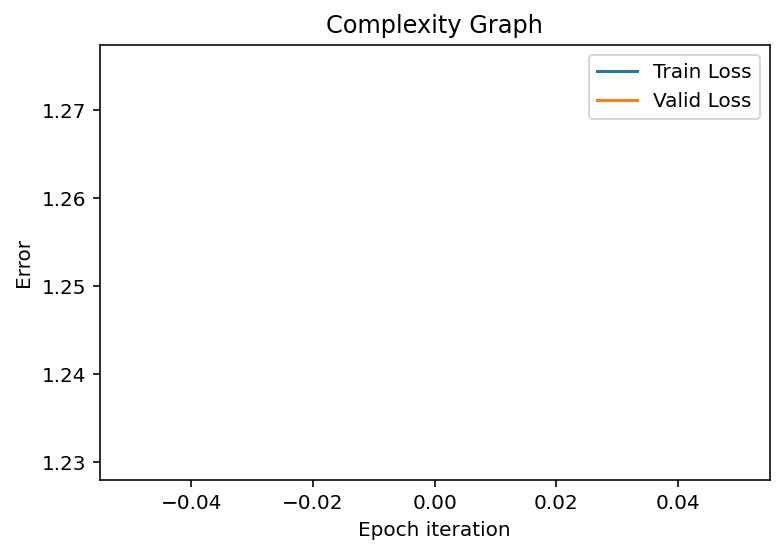

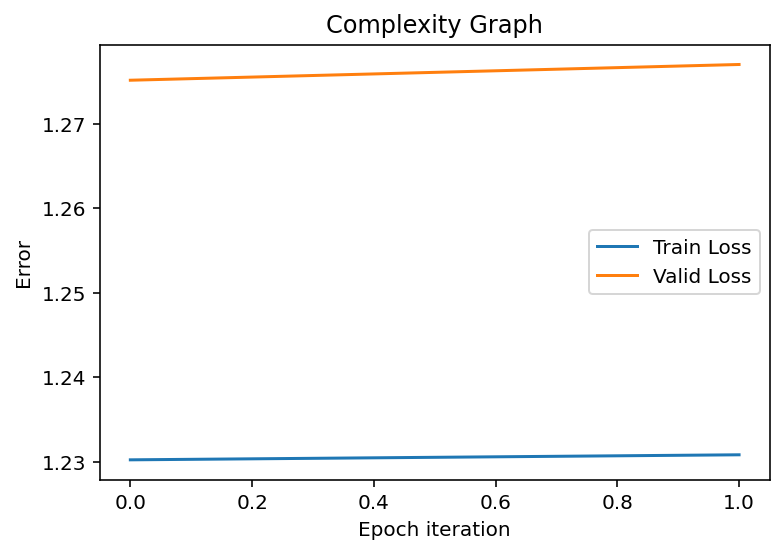

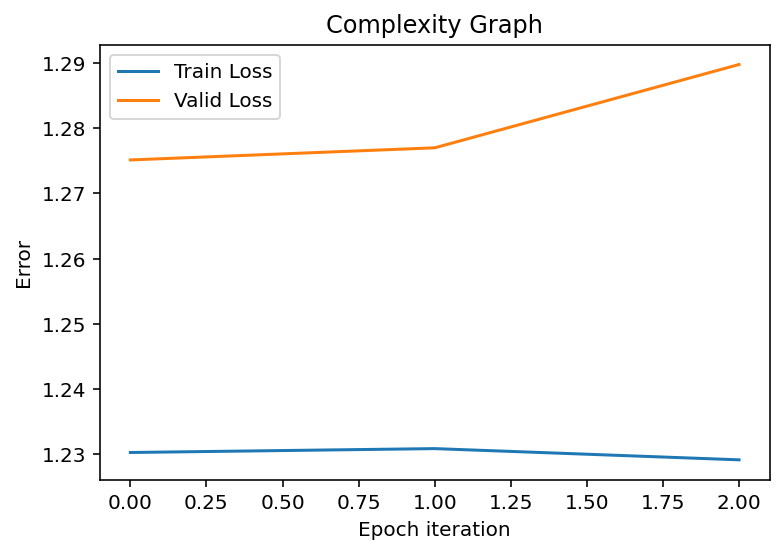

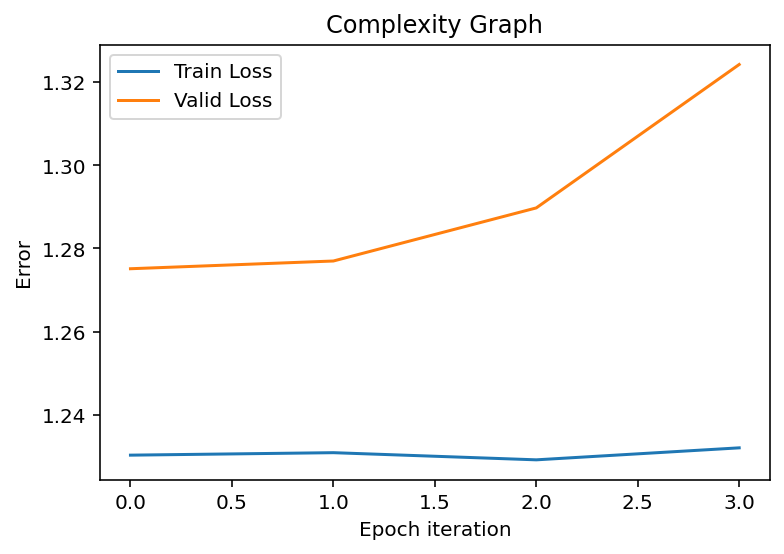

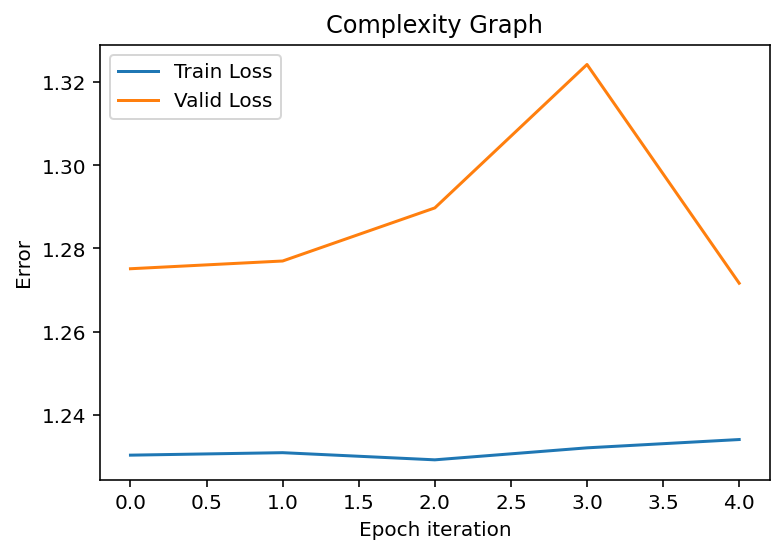

...

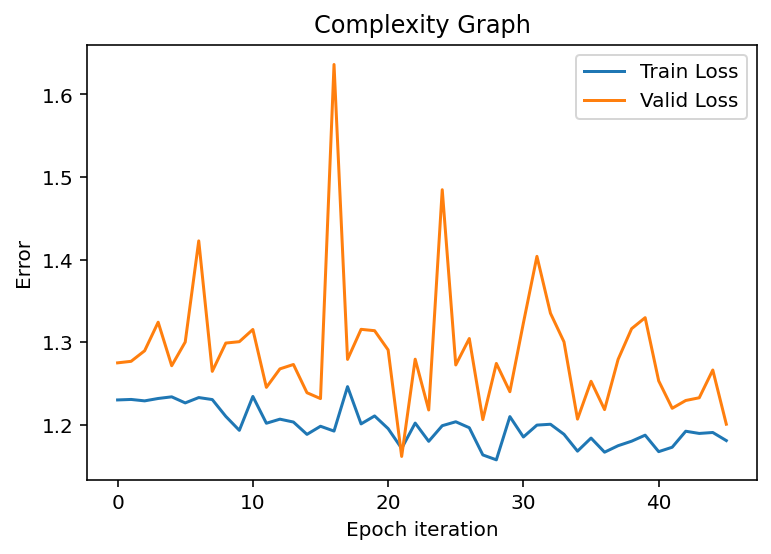

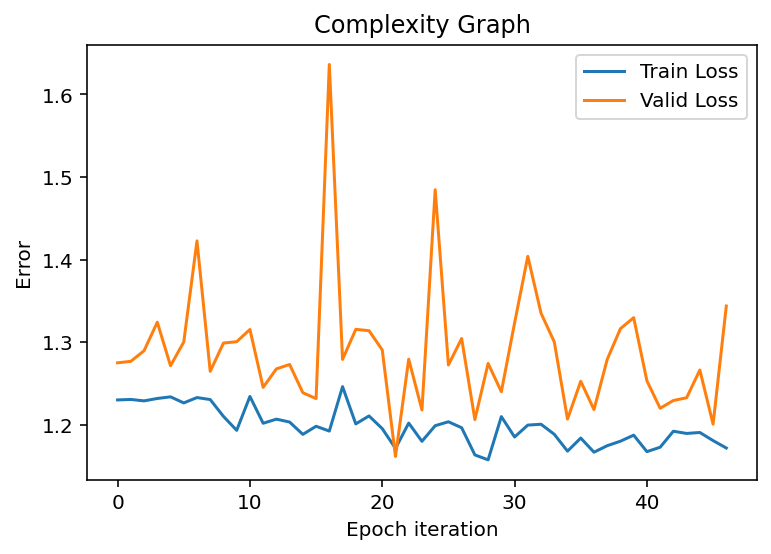

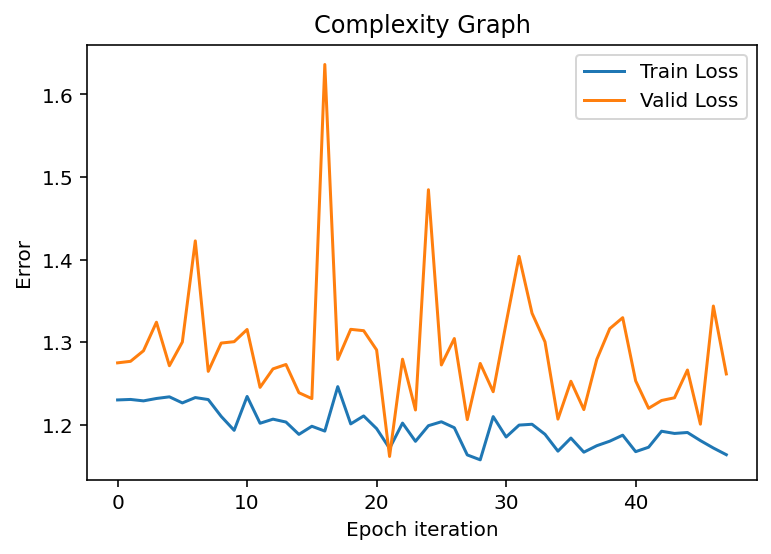

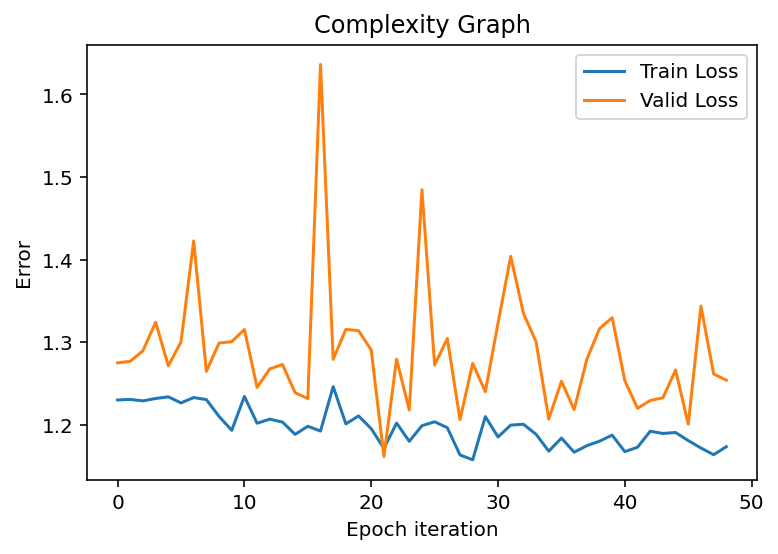

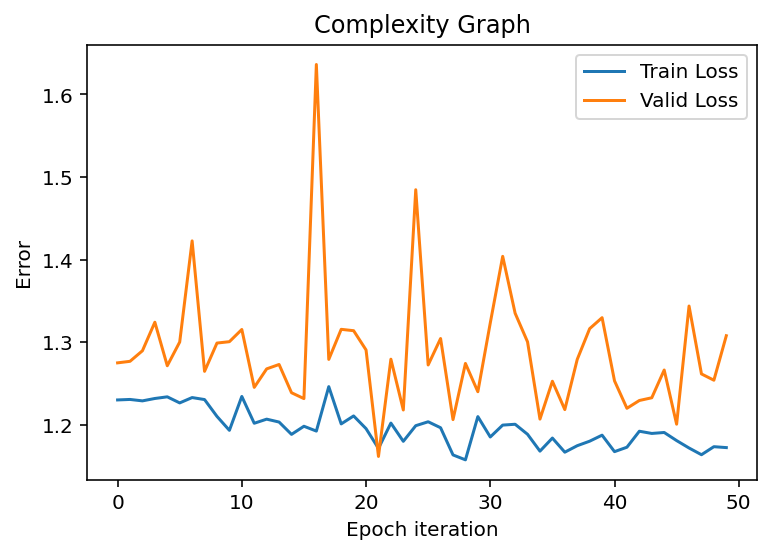

In [33]:
#open the training log file
#f = open(log_file, 'w')
# number of epochs to train the model
n_epochs = 50

valid_loss_min = np.Inf # track change in validation loss
Tloss_values = []
Vloss_values = []

for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    
    train_loss = 0.0
    valid_loss = 0.0
    
    ###################
    # train the model #
    ###################
    model.train()
    for data, target in trainLoader:
        # move tensors to GPU if CUDA is available
        if train_on_gpu:
            data, target = data.cuda(), target.cuda()
        # clear the gradients of all optimized variables to zero
        optimizer.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the batch loss
        loss = lossFunction(output, target)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer.step()
        # update training loss
        train_loss += loss.item()*data.size(0)
    Tloss_values.append(train_loss/len(trainLoader.sampler))
        #Tloss_values.append(train_loss/len(trainLoader))
        

  #plt.plot(loss_values)
        
    ######################    
    # validate the model #
    ######################
    model.eval()
    for data, target in validLoader:
        # move tensors to GPU if CUDA is available
        if train_on_gpu:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the batch loss
        loss = lossFunction(output, target)
        # update average validation loss 
        # loss = losses in float * batchSize
        valid_loss += loss.item()*data.size(0)
    Vloss_values.append(valid_loss / len(validLoader.sampler))

    
    # calculate average losses
    train_loss = train_loss/len(trainLoader.sampler)
    valid_loss = valid_loss/len(validLoader.sampler)
        
    # print training/validation statistics 
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch, train_loss, valid_loss))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save(model.state_dict(), '/content/drive/My Drive/Colab Notebooks/Block Net/model_BlockNet(dropout2).pt')
        valid_loss_min = valid_loss
    fig,ax = plt.subplots()    
    ax.plot(Tloss_values, label="Train Loss")
    ax.plot(Vloss_values, label="Valid Loss")
    ax.set_title("Complexity Graph")
    ax.set_xlabel('Epoch iteration')
    ax.set_ylabel('Error')
    ax.legend()
    #plt.show()

    # plt.figure(figsize=(10,5))
    # plt.title("Training and Validation Loss")
    # plt.plot(Vloss_values,label="val")
    # plt.plot(Tloss_values,label="train")
    # plt.xlabel("iterations")
    # plt.ylabel("Loss")
    # plt.legend()
    # plt.show()
#close the training log file
#f.close()

Epoch: 1 	Training Loss: 1.170159 	Validation Loss: 1.184224
Validation loss decreased (inf --> 1.184224).  Saving model ...
Epoch: 2 	Training Loss: 1.153318 	Validation Loss: 1.175093
Validation loss decreased (1.184224 --> 1.175093).  Saving model ...
Epoch: 3 	Training Loss: 1.162215 	Validation Loss: 1.191112
Epoch: 4 	Training Loss: 1.164894 	Validation Loss: 1.248000
Epoch: 5 	Training Loss: 1.156742 	Validation Loss: 1.228025
Epoch: 6 	Training Loss: 1.162219 	Validation Loss: 1.175800
Epoch: 7 	Training Loss: 1.176181 	Validation Loss: 1.334080
Epoch: 8 	Training Loss: 1.151939 	Validation Loss: 1.274145
Epoch: 9 	Training Loss: 1.159570 	Validation Loss: 1.181959
Epoch: 10 	Training Loss: 1.160830 	Validation Loss: 1.204447
Epoch: 11 	Training Loss: 1.163730 	Validation Loss: 1.227098
Epoch: 12 	Training Loss: 1.166884 	Validation Loss: 1.268371
Epoch: 13 	Training Loss: 1.165060 	Validation Loss: 1.244363
Epoch: 14 	Training Loss: 1.160628 	Validation Loss: 1.187845
Epoch: 1

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:76: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Epoch: 22 	Training Loss: 1.169613 	Validation Loss: 1.257491
Epoch: 23 	Training Loss: 1.160283 	Validation Loss: 1.240523
Epoch: 24 	Training Loss: 1.155019 	Validation Loss: 1.247961
Epoch: 25 	Training Loss: 1.156003 	Validation Loss: 1.203586
Epoch: 26 	Training Loss: 1.166726 	Validation Loss: 1.237355
Epoch: 27 	Training Loss: 1.161169 	Validation Loss: 1.274131
Epoch: 28 	Training Loss: 1.156317 	Validation Loss: 1.175409
Epoch: 29 	Training Loss: 1.163619 	Validation Loss: 1.173482
Validation loss decreased (1.175093 --> 1.173482).  Saving model ...
Epoch: 30 	Training Loss: 1.147458 	Validation Loss: 1.309258
Epoch: 31 	Training Loss: 1.167469 	Validation Loss: 1.226841
Epoch: 32 	Training Loss: 1.154224 	Validation Loss: 1.237070
Epoch: 33 	Training Loss: 1.157802 	Validation Loss: 1.234423
Epoch: 34 	Training Loss: 1.161565 	Validation Loss: 1.277143
Epoch: 35 	Training Loss: 1.157444 	Validation Loss: 1.234267
Epoch: 36 	Training Loss: 1.132587 	Validation Loss: 1.179075
E

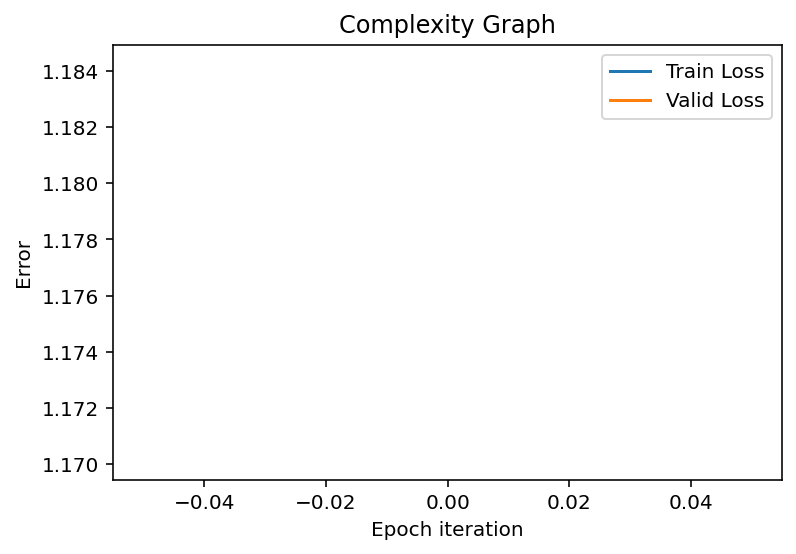

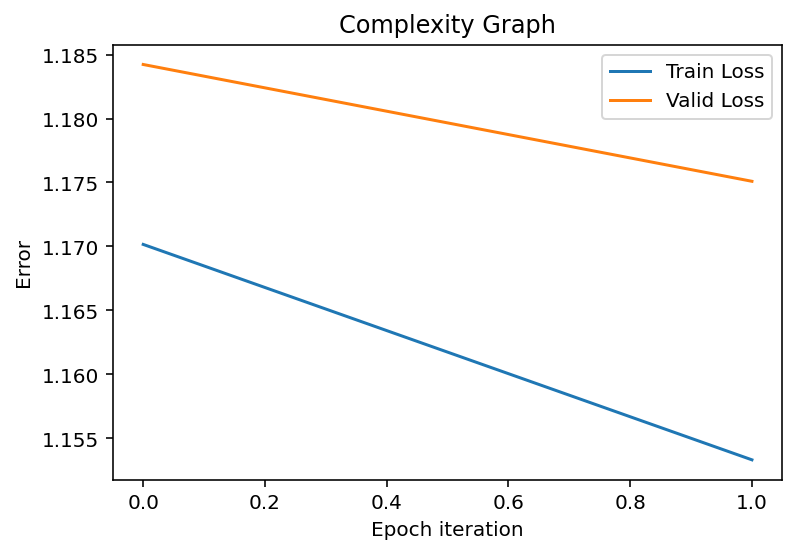

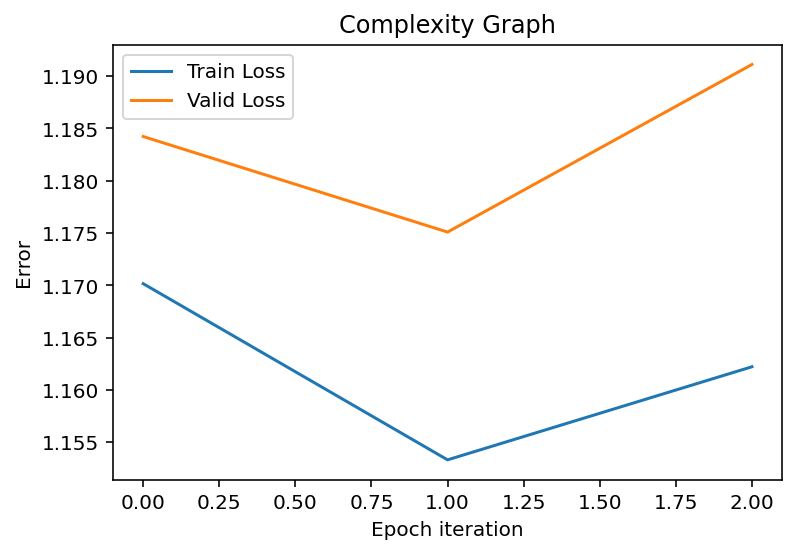

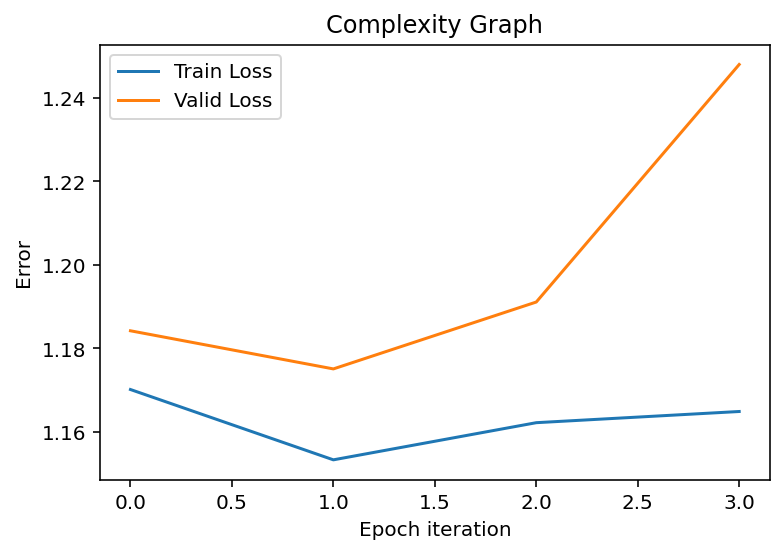

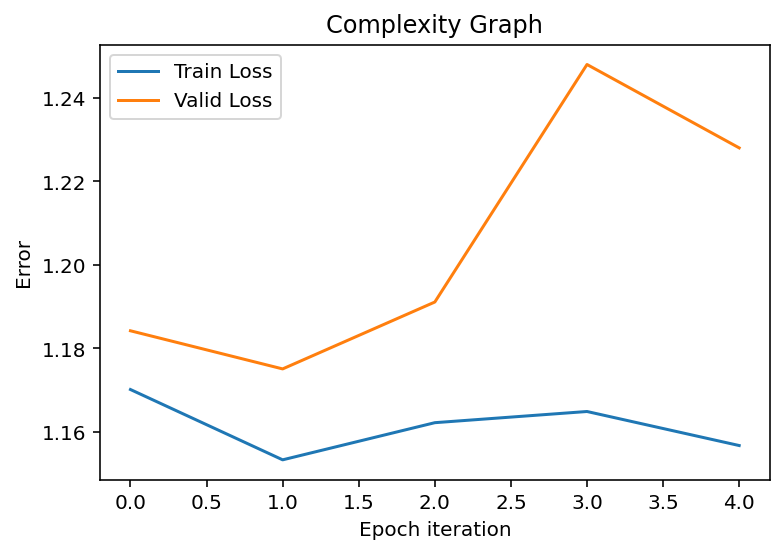

...

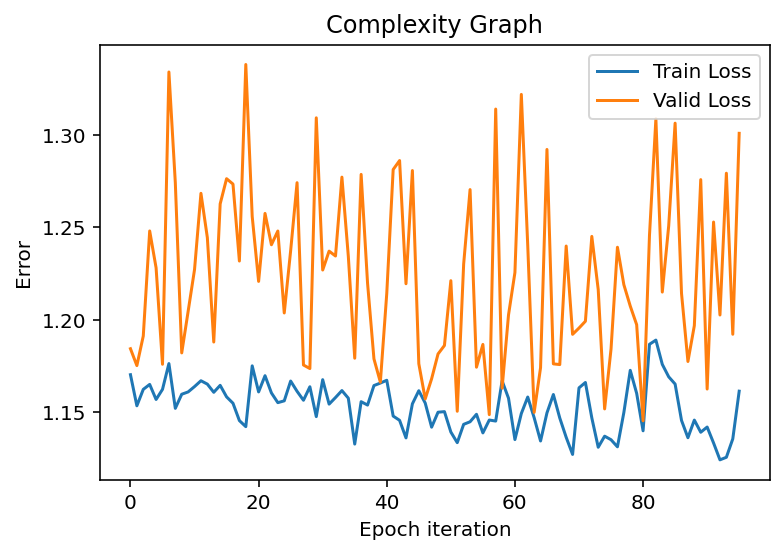

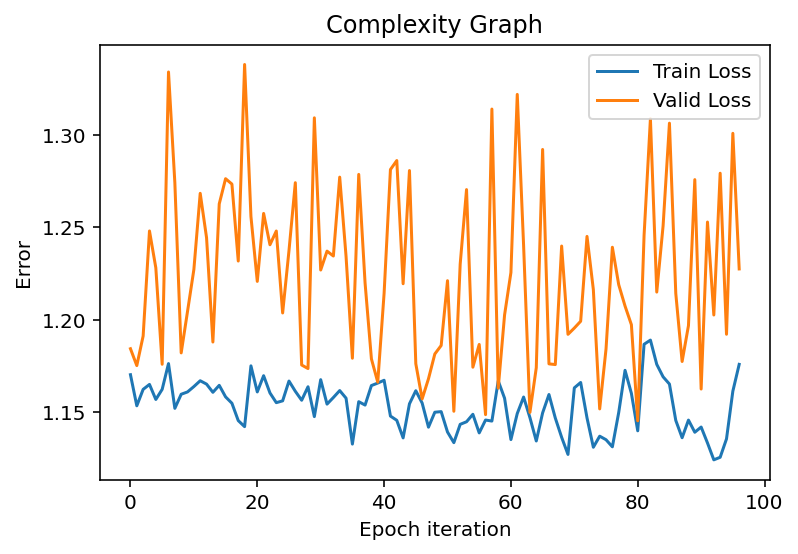

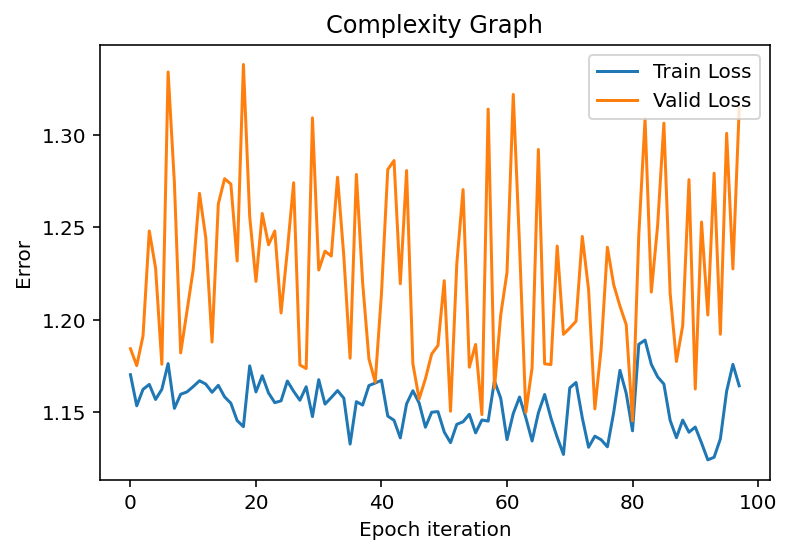

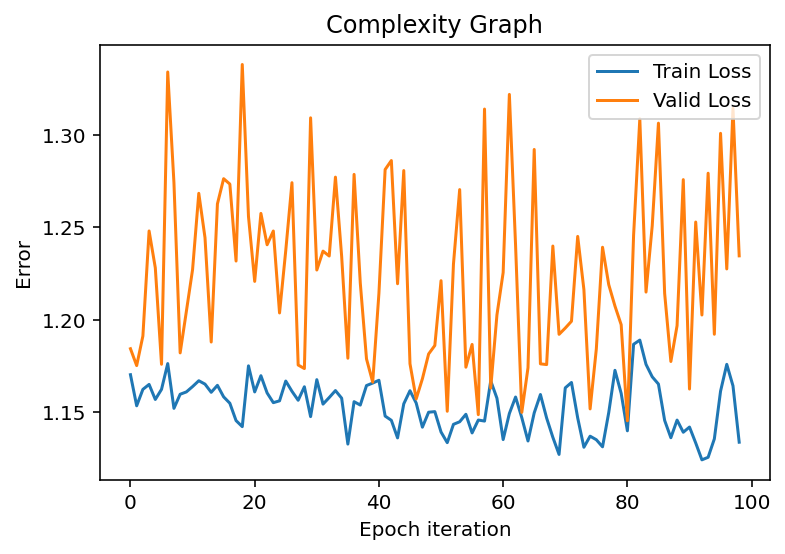

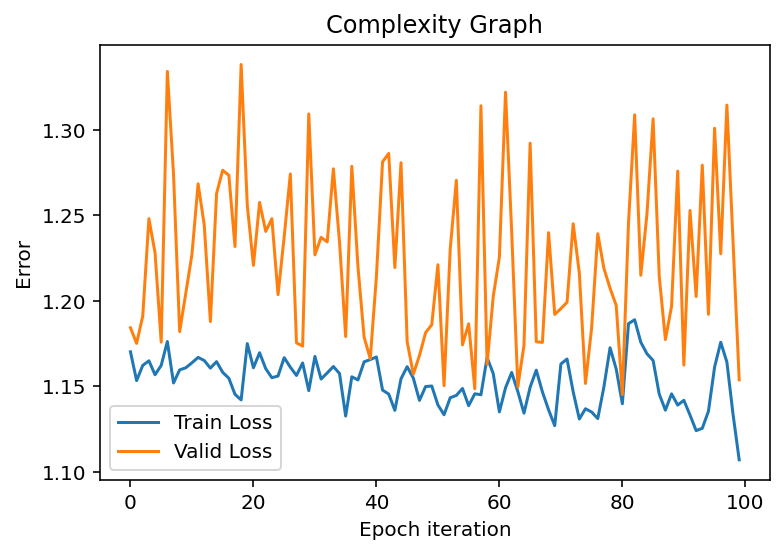

In [34]:
#open the training log file
#f = open(log_file, 'w')
# number of epochs to train the model
n_epochs = 100

valid_loss_min = np.Inf # track change in validation loss
Tloss_values = []
Vloss_values = []

for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    
    train_loss = 0.0
    valid_loss = 0.0
    
    ###################
    # train the model #
    ###################
    model.train()
    for data, target in trainLoader:
        # move tensors to GPU if CUDA is available
        if train_on_gpu:
            data, target = data.cuda(), target.cuda()
        # clear the gradients of all optimized variables to zero
        optimizer.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the batch loss
        loss = lossFunction(output, target)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer.step()
        # update training loss
        train_loss += loss.item()*data.size(0)
    Tloss_values.append(train_loss/len(trainLoader.sampler))
        #Tloss_values.append(train_loss/len(trainLoader))
        

  #plt.plot(loss_values)
        
    ######################    
    # validate the model #
    ######################
    model.eval()
    for data, target in validLoader:
        # move tensors to GPU if CUDA is available
        if train_on_gpu:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the batch loss
        loss = lossFunction(output, target)
        # update average validation loss 
        # loss = losses in float * batchSize
        valid_loss += loss.item()*data.size(0)
    Vloss_values.append(valid_loss / len(validLoader.sampler))

    
    # calculate average losses
    train_loss = train_loss/len(trainLoader.sampler)
    valid_loss = valid_loss/len(validLoader.sampler)
        
    # print training/validation statistics 
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch, train_loss, valid_loss))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save(model.state_dict(), '/content/drive/My Drive/Colab Notebooks/Block Net/model_BlockNet(dropout3).pt')
        valid_loss_min = valid_loss
    fig,ax = plt.subplots()    
    ax.plot(Tloss_values, label="Train Loss")
    ax.plot(Vloss_values, label="Valid Loss")
    ax.set_title("Complexity Graph")
    ax.set_xlabel('Epoch iteration')
    ax.set_ylabel('Error')
    ax.legend()
    #plt.show()

    # plt.figure(figsize=(10,5))
    # plt.title("Training and Validation Loss")
    # plt.plot(Vloss_values,label="val")
    # plt.plot(Tloss_values,label="train")
    # plt.xlabel("iterations")
    # plt.ylabel("Loss")
    # plt.legend()
    # plt.show()
#close the training log file
#f.close()

In [35]:
        
model.load_state_dict(torch.load('model_BlockNet(dropout3).pt'))

<All keys matched successfully>

In [36]:
## track test loss

test_loss = 0.0
class_correct = list(0. for i in range(5))
totalClass = list(0. for i in range(5))
batchSize = 34

model.eval()
#iterate over the test data

for data,labels in testLoader:
  # move tensors to GPU if CUDA is available
  if train_on_gpu:
    data,labels = data.cuda(), labels.cuda() 
    # forward pass: Compute predicted outputs by passing inputs to the model
    output = model(data)
    #calculate the batch loss
    loss = lossFunction(output, labels)
    #update test loss
    test_loss += loss.item()*data.size(0)
    #convert output probabilities to predicted class
    _, pred = torch.max(output,1)
    #compare predictions to true label
    correct_tensor = pred.eq(labels.data.view_as(pred))
    correct = np.squeeze(correct_tensor.numpy()) if not train_on_gpu else np.squeeze(correct_tensor.cpu().numpy())
    #cal test accuracy for each object class
    for i in range(5):
      label = labels.data[i]
      class_correct[label] += correct[i].item()
      totalClass[label] += 1


# average test loss
test_loss = test_loss/len(testLoader.dataset)
print('Test Loss: {:.6f}\n'.format(test_loss))

for i in range(5):
  if totalClass[i]>0:
    print('Test Accuracy of %5s: %2d%% (%2d/%2d)'%(classes[i], 100*class_correct[i] / totalClass[i], np.sum(class_correct[i]), np.sum(totalClass[i])))

  else:
    print('Test Accuracy of %5s: N/A (no training examples)' % (classes[i]))
    #print("\nTest Accuracy (OverAll): %2d%% (%2d/%2d)"%(100. *np.sum(class_correct) / np.sum(totalClass), np.sum(class_correct), np.sum(totalClass)))

print('\nTest Accuracy (Overall): %2d%% (%2d/%2d)'%(100. *np.sum(class_correct) / np.sum(totalClass),np.sum(class_correct), np.sum(totalClass)))

Test Loss: 1.687545

Test Accuracy of adenosis: 65% (36/55)
Test Accuracy of ductal_carcinoma:  3% ( 2/58)
Test Accuracy of fibroadenoma:  4% ( 2/47)
Test Accuracy of mucinous_carcinoma: 23% (14/60)
Test Accuracy of tubular_adenoma:  0% ( 0/60)

Test Accuracy (Overall): 19% (54/280)


In [ ]:
## track test loss

test_loss = 0.0
class_correct = list(0. for i in range(5))
totalClass = list(0. for i in range(5))
batchSize = 34

model.eval()
#iterate over the test data

for data,labels in testLoader:
  # move tensors to GPU if CUDA is available
  if train_on_gpu:
    data,labels = data.cuda(), labels.cuda()

    print(data.size())
    print('''########################################\n LABELs
      {}, \n {}
    '''.format(labels.size(),type(labels)))
    
    # forward pass: Compute predicted outputs by passing inputs to the model
    output = model(data)
    #calculate the batch loss
    loss = lossFunction(output, labels)
    #update test loss
    test_loss += loss.item()*data.size(0)
    #convert output probabilities to predicted class
    _, pred = torch.max(output,1)
    #compare predictions to true label
    correct_tensor = pred.eq(labels.data.view_as(pred))
    correct = np.squeeze(correct_tensor.numpy()) if not train_on_gpu else np.squeeze(correct_tensor.cpu().numpy())
    #cal test accuracy for each object class
    for i in range(5):
      label = labels.data[i]
      class_correct[label] += correct[i].item()
      totalClass[label] += 1


# average test loss
test_loss = test_loss/len(testLoader.dataset)
print('Test Loss: {:.6f}\n'.format(test_loss))

for i in range(5):
  if totalClass[i]>0:
    print('Test Accuracy of %5s: %2d%% (%2d/%2d)'%(classes[i], 100*class_correct[i] / totalClass[i], np.sum(class_correct[i]), np.sum(totalClass[i])))

  else:
    print('Test Accuracy of %5s: N/A (no training examples)' % (classes[i]))
    #print("\nTest Accuracy (OverAll): %2d%% (%2d/%2d)"%(100. *np.sum(class_correct) / np.sum(totalClass), np.sum(class_correct), np.sum(totalClass)))

print('\nTest Accuracy (Overall): %2d%% (%2d/%2d)'%(100. *np.sum(class_correct) / np.sum(totalClass),np.sum(class_correct), np.sum(totalClass)))

torch.Size([34, 3, 227, 227])
########################################
 LABELs
      torch.Size([34]), 
 <class 'torch.Tensor'>
    


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


torch.Size([34, 3, 227, 227])
########################################
 LABELs
      torch.Size([34]), 
 <class 'torch.Tensor'>
    
torch.Size([34, 3, 227, 227])
########################################
 LABELs
      torch.Size([34]), 
 <class 'torch.Tensor'>
    
torch.Size([34, 3, 227, 227])
########################################
 LABELs
      torch.Size([34]), 
 <class 'torch.Tensor'>
    
torch.Size([34, 3, 227, 227])
########################################
 LABELs
      torch.Size([34]), 
 <class 'torch.Tensor'>
    
torch.Size([34, 3, 227, 227])
########################################
 LABELs
      torch.Size([34]), 
 <class 'torch.Tensor'>
    
torch.Size([34, 3, 227, 227])
########################################
 LABELs
      torch.Size([34]), 
 <class 'torch.Tensor'>
    
torch.Size([34, 3, 227, 227])
########################################
 LABELs
      torch.Size([34]), 
 <class 'torch.Tensor'>
    
torch.Size([34, 3, 227, 227])
#######################################

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


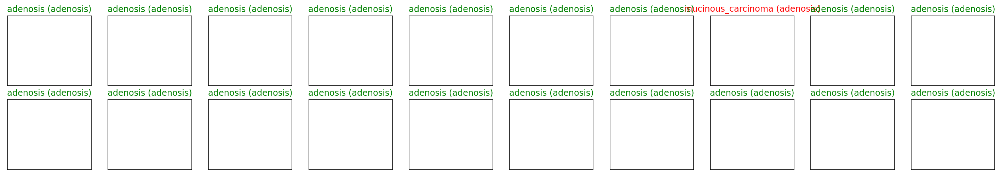

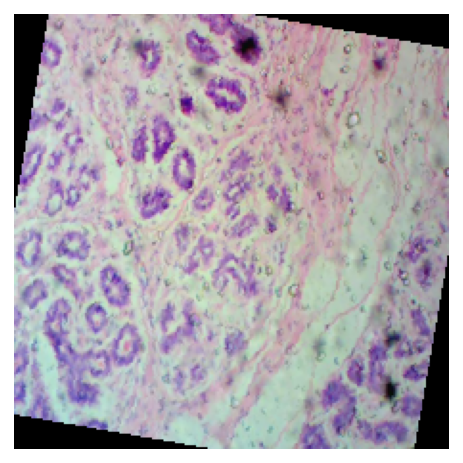

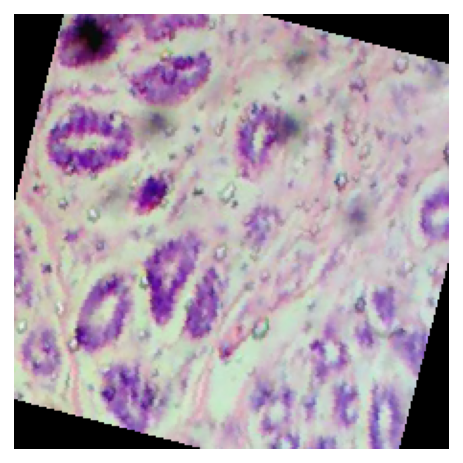

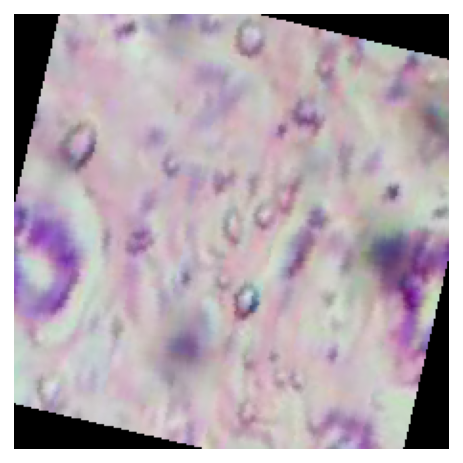

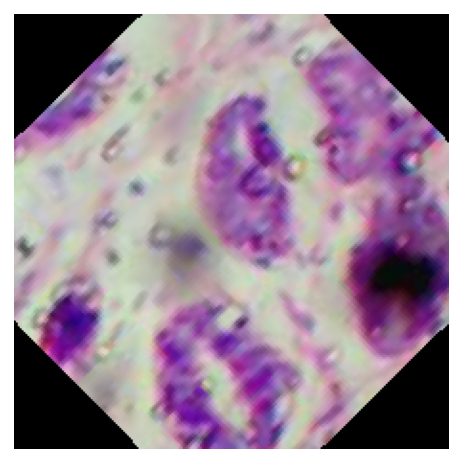

...

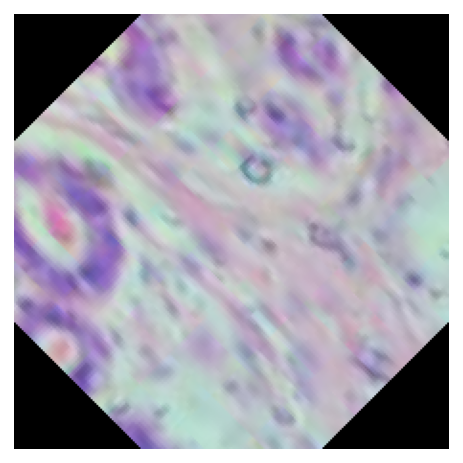

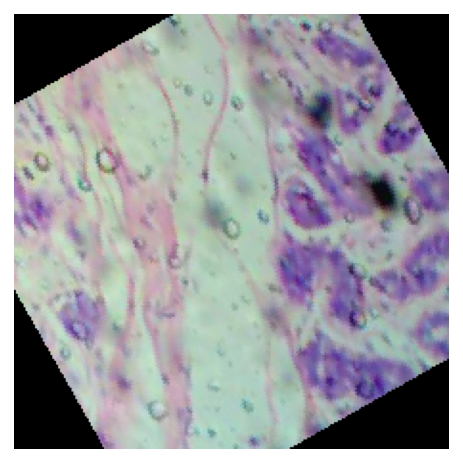

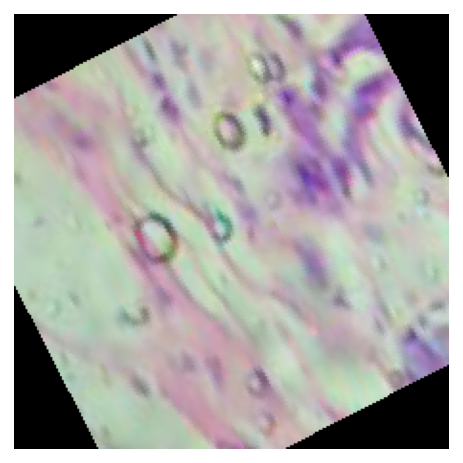

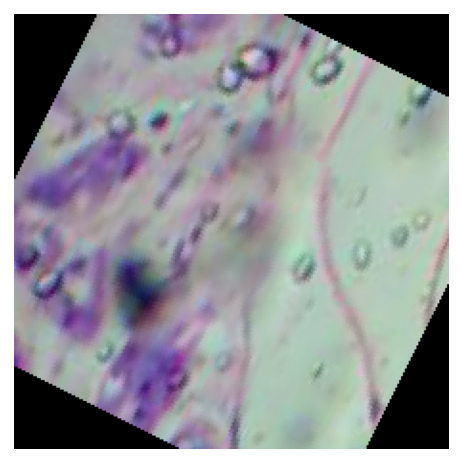

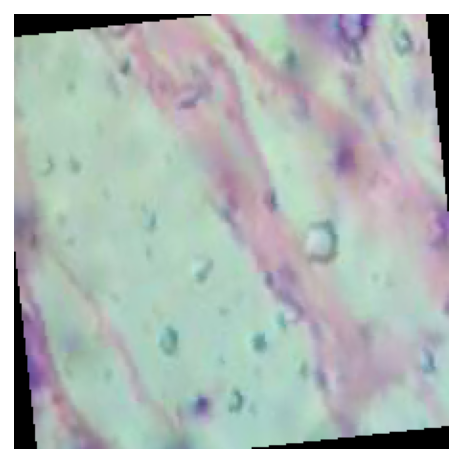

In [ ]:
# obtain one batch of test images
dataiter = iter(testLoader)
images, labels = dataiter.next()
images.numpy()

# move model inputs to cuda, if GPU available
if train_on_gpu:
    images = images.cuda()

# get sample outputs
output = model(images)
# convert output probabilities to predicted class
_, preds_tensor = torch.max(output, 1)
preds = np.squeeze(preds_tensor.numpy()) if not train_on_gpu else np.squeeze(preds_tensor.cpu().numpy())

# plot the images in the batch, along with predicted and true labels
fig = plt.figure(figsize=(25, 4))
for idx in np.arange(20):
    ax = fig.add_subplot(2, 16/2, idx+1, xticks=[], yticks=[])
    imshow(images[idx] if not train_on_gpu else images[idx].cpu())
    ax.set_title("{} ({})".format(classes[preds[idx]], classes[labels[idx]]),
                 color=("green" if preds[idx]==labels[idx].item() else "red"))

In [ ]:
# from torch.utils.tensorboard import SummaryWriter

# # default `log_dir` is "runs" - we'll be more specific here
# writer = SummaryWriter('runs/fashion_mnist_experiment_1')

In [ ]:
# "/content/drive/MyDrive/Colab Notebooks"
"/content/drive/My Drive/Colab Notebooks"